In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import warnings
warnings.filterwarnings('ignore')

In [3]:
data = pd.read_csv('covid-variants.csv')
data.head(5)

,location,date,variant,num_sequences,perc_sequences,num_sequences_total
0,Angola,2020-07-06,Alpha,0,0.0,3
1,Angola,2020-07-06,B.1.1.277,0,0.0,3
2,Angola,2020-07-06,B.1.1.302,0,0.0,3
3,Angola,2020-07-06,B.1.1.519,0,0.0,3
4,Angola,2020-07-06,B.1.160,0,0.0,3


In [4]:
data.shape

(100416, 6)

In [6]:
data.describe()

,num_sequences,perc_sequences,num_sequences_total
count,100416.000000,100416.000000,100416.000000
mean,72.171676,6.154355,1509.582457
std,1669.262169,21.898989,8445.291772
min,0.000000,-0.010000,1.000000
25%,0.000000,0.000000,12.000000
50%,0.000000,0.000000,59.000000
75%,0.000000,0.000000,394.000000
max,142280.000000,100.000000,146170.000000


In [7]:
data.isna().sum()

location               0
date                   0
variant                0
num_sequences          0
perc_sequences         0
num_sequences_total    0
dtype: int64

In [8]:
data.duplicated().sum()

0

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100416 entries, 0 to 100415
Data columns (total 6 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   location             100416 non-null  object 
 1   date                 100416 non-null  object 
 2   variant              100416 non-null  object 
 3   num_sequences        100416 non-null  int64  
 4   perc_sequences       100416 non-null  float64
 5   num_sequences_total  100416 non-null  int64  
dtypes: float64(1), int64(2), object(3)
memory usage: 4.6+ MB


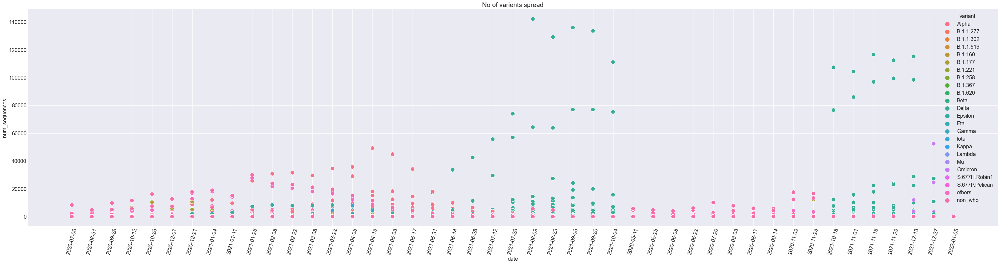

In [12]:
plt.figure(figsize=(52,12))
sns.scatterplot(data['date'],data['num_sequences'],hue=data['variant'])
#plt.style.use('seaborn-darkgrid')
plt.title("No of varients spread")
plt.xticks(rotation=75)
plt.show()

In [13]:
data.groupby(['num_sequences']).count()

,location,date,variant,perc_sequences,num_sequences_total
num_sequences,,,,,
0,84173,84173,84173,84173,84173
1,2753,2753,2753,2753,2753
2,1405,1405,1405,1405,1405
3,905,905,905,905,905
4,631,631,631,631,631
...,...,...,...,...,...
116690,1,1,1,1,1
129262,1,1,1,1,1
133718,1,1,1,1,1


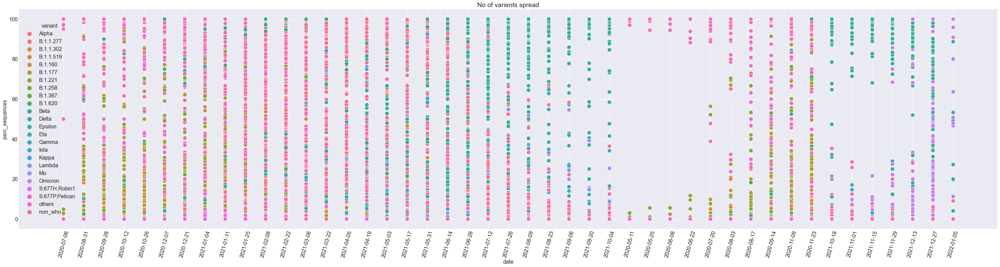

In [15]:
plt.figure(figsize=(52,12))
sns.scatterplot(data['date'],data['perc_sequences'],hue=data['variant'])
#plt.style.use('seaborn-darkgrid')
plt.title("No of varients spread")
plt.xticks(rotation=75)
plt.show()

In [16]:
data.groupby(['perc_sequences']).count()

,location,date,variant,num_sequences,num_sequences_total
perc_sequences,,,,,
-0.01,26,26,26,26,26
0.00,84252,84252,84252,84252,84252
0.01,238,238,238,238,238
0.02,176,176,176,176,176
0.03,168,168,168,168,168
...,...,...,...,...,...
99.96,9,9,9,9,9
99.97,5,5,5,5,5
99.98,7,7,7,7,7


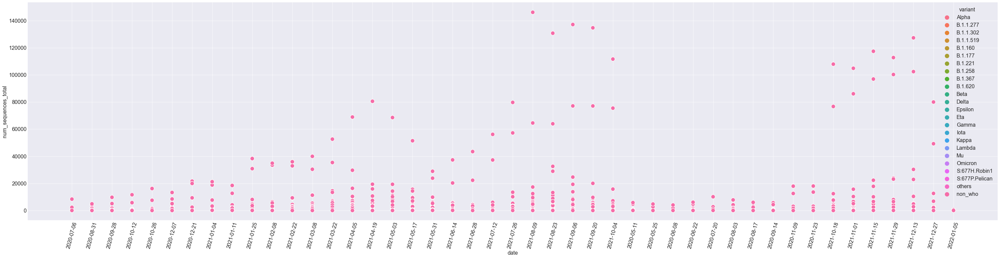

In [17]:
plt.figure(figsize=(52,12))
sns.scatterplot(data['date'],data['num_sequences_total'],hue=data['variant'])
#plt.style.use('seaborn-darkgrid')
#plt.title("No of varients spread")
plt.xticks(rotation=75)
plt.show()

In [18]:
data.groupby(['num_sequences_total']).count()

,location,date,variant,num_sequences,perc_sequences
num_sequences_total,,,,,
1,4920,4920,4920,4920,4920
2,3624,3624,3624,3624,3624
3,2712,2712,2712,2712,2712
4,2256,2256,2256,2256,2256
5,2040,2040,2040,2040,2040
...,...,...,...,...,...
127342,24,24,24,24,24
130754,24,24,24,24,24
134718,24,24,24,24,24


In [20]:
data.groupby(['location']).count()

,date,variant,num_sequences,perc_sequences,num_sequences_total
location,,,,,
Angola,672,672,672,672,672
Argentina,1056,1056,1056,1056,1056
Aruba,600,600,600,600,600
Australia,1056,1056,1056,1056,1056
Austria,1032,1032,1032,1032,1032
...,...,...,...,...,...
United States,1080,1080,1080,1080,1080
Uruguay,576,576,576,576,576
Vietnam,504,504,504,504,504


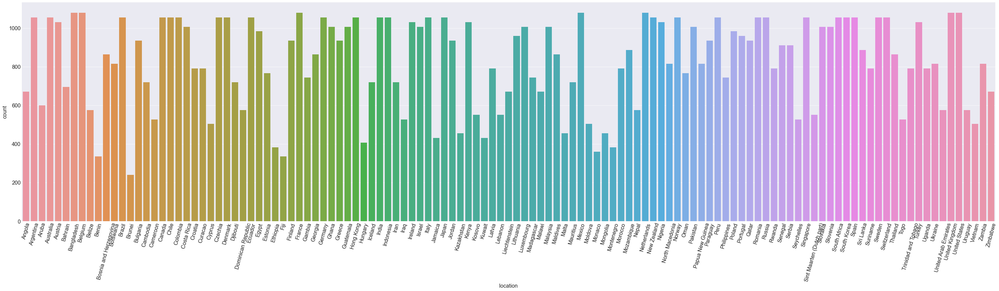

In [21]:
plt.figure(figsize=(52,12))
sns.countplot(data['location'])
#plt.style.use('seaborn-darkgrid')
#plt.title("No of varients spread")
plt.xticks(rotation=75)
plt.show()

In [22]:
data.groupby(['variant']).count()

,location,date,num_sequences,perc_sequences,num_sequences_total
variant,,,,,
Alpha,4184,4184,4184,4184,4184
B.1.1.277,4184,4184,4184,4184,4184
B.1.1.302,4184,4184,4184,4184,4184
B.1.1.519,4184,4184,4184,4184,4184
B.1.160,4184,4184,4184,4184,4184
B.1.177,4184,4184,4184,4184,4184
B.1.221,4184,4184,4184,4184,4184
B.1.258,4184,4184,4184,4184,4184
B.1.367,4184,4184,4184,4184,4184


In [23]:
px.box(data, y=data['num_sequences'],color='variant', animation_frame=data['date'])

In [24]:
px.line(data, y=data['num_sequences'],color='variant', animation_frame=data['date'])

In [25]:
!pip install pycountry

In [26]:
import pycountry

input_countries = data['location']

countries = {}
for country in pycountry.countries:
    countries[country.name] = country.alpha_3

codes = [countries.get(country, 'Unknown code') for country in input_countries]

In [28]:
fig = px.choropleth(data, locations=codes,
                    color='perc_sequences',
                    animation_frame='date',
                    title = "perc_sequences",
                    color_continuous_scale='Bluered',template='plotly_dark')
#fig["layout"].pop("updatemenus")
fig.show()

In [30]:
fig = px.choropleth(data, locations=codes,
                    color='num_sequences',
                    animation_frame='date',
                    title = "num_sequences",
                    color_continuous_scale='Bluered',template='plotly_dark')
#fig["layout"].pop("updatemenus")
fig.show()

In [31]:
fig = px.choropleth(data, locations=codes,
                    color='num_sequences_total',
                    animation_frame='date',
                    title = "num_sequences_total",
                    color_continuous_scale='Bluered',template='plotly_dark')
#fig["layout"].pop("updatemenus")
fig.show()